In [1]:
from transformers import BertTokenizer

from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
import torch.nn as nn
import torch

from torchvision.models import feature_extraction
import torchvision

import matplotlib.pyplot as plt
from tqdm import tqdm
from PIL import Image
import numpy as np
import os

In [2]:
# set seeds for reproducibility
SEED = 123
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.cuda.manual_seed_all(SEED)

torch.backends.cudnn.deterministic = True

In [5]:
DATA_DIR = "/kaggle/input/flickr8kimagescaptions/flickr8k"
IMAGES_DIR = os.path.join(DATA_DIR, 'images')

SPLIT_RATIO = {
    'train': 0.7,
    'val': 0.15,
    'test': 0.15,
}
N_EPOCHS = 10
BATCH_SIZE = 128
EMBED_SIZE = 768
LEARNING_RATE = 1e-4
NHEAD=1
NUM_LAYERS=1
BEST_MODEL_FILEPATH = "best_model.pt"
EARLY_STOPPING_STEP_SIZE = 5
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'

# ViT feature extractor
WEIGHTS = torchvision.models.ViT_B_16_Weights.DEFAULT
BASE_MODEL = torchvision.models.vit_b_16
FEAT_LAYER = "getitem_5"
FEAT_DIMS = 768

DEVICE

'cuda'

In [6]:
def load_data(fp):
    with open(fp, mode='r') as f:
        data = [row.strip().replace('"', '').split(',', 1) for idx, row in enumerate(f) if idx > 0]
    return zip(*data) 

data_filepath = os.path.join(DATA_DIR, 'captions.txt')
images, captions = load_data(data_filepath)
assert len(images) == len(captions)

n_data = len(images)
print(f"There are {n_data} images and captions")

There are 40455 images and captions


In [7]:
# initialize tokenizer
tokenizer = BertTokenizer.from_pretrained("bert-base-cased")

max_seq_len = max([len(tokenizer(caption).input_ids) for caption in tqdm(captions)])
print(f"Maximum sequence length in the dataset = {max_seq_len}")

tokenizer_config.json:   0%|          | 0.00/49.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/213k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/436k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

100%|██████████| 40455/40455 [00:15<00:00, 2656.54it/s]

Maximum sequence length in the dataset = 43


In [8]:
# get the size of train, val and test sets
n_train = int(n_data * SPLIT_RATIO['train'])
n_val = int(n_data * SPLIT_RATIO['val'])
n_test = n_data - (n_train + n_val)

# permute all indices
indices = np.random.permutation(n_data)

# get train, val and test set indices
train_indices = indices[:n_train]
val_indices = indices[n_train:(n_train + n_val)]
test_indices = indices[(n_train + n_val):]

assert len(np.intersect1d(train_indices, val_indices)) == 0
assert len(np.intersect1d(train_indices, test_indices)) == 0
assert len(np.intersect1d(val_indices, test_indices)) == 0

In [9]:
def get_split(images, captions, indices):
    return zip(*[(images[idx], captions[idx]) for idx in indices])
    
train_images, train_captions = get_split(images, captions, train_indices)
val_images, val_captions = get_split(images, captions, val_indices)
test_images, test_captions = get_split(images, captions, test_indices)

print(f"There are {n_train} train data, {n_val} validation data and {n_test} test data.")

There are 28318 train data, 6068 validation data and 6069 test data.


In [10]:
def initialize_feature_extractor(base_model, weights, feat_layer, device):
    # initialize model
    feature_extractor = torchvision.models.feature_extraction.create_feature_extractor(
        BASE_MODEL(weights=WEIGHTS),
        [FEAT_LAYER],
    ).to(device)
    # freeze params
    for param in feature_extractor.parameters():
        param.requires_grad = False
    # set model to evaluation mode
    feature_extractor = feature_extractor.eval()

    # initialize image transformations
    transforms = WEIGHTS.transforms()
    return feature_extractor, transforms

feature_extractor, transforms = initialize_feature_extractor(BASE_MODEL, WEIGHTS, FEAT_LAYER, device=DEVICE)

Downloading: "https://download.pytorch.org/models/vit_b_16-c867db91.pth" to /root/.cache/torch/hub/checkpoints/vit_b_16-c867db91.pth
100%|██████████| 330M/330M [00:01<00:00, 183MB/s] 
/opt/conda/lib/python3.10/site-packages/torch/overrides.py:110: UserWarning: 'has_cuda' is deprecated, please use 'torch.backends.cuda.is_built()'
  torch.has_cuda,
/opt/conda/lib/python3.10/site-packages/torch/overrides.py:111: UserWarning: 'has_cudnn' is deprecated, please use 'torch.backends.cudnn.is_available()'
  torch.has_cudnn,
/opt/conda/lib/python3.10/site-packages/torch/overrides.py:117: UserWarning: 'has_mps' is deprecated, please use 'torch.backends.mps.is_built()'
  torch.has_mps,
/opt/conda/lib/python3.10/site-packages/torch/overrides.py:118: UserWarning: 'has_mkldnn' is deprecated, please use 'torch.backends.mkldnn.is_available()'
  torch.has_mkldnn,


In [35]:
class FlickrDset(Dataset):
    def __init__(self, images, captions, transforms, tokenizer):
        super().__init__()
        self.images = images
        self.captions = captions
        self.transforms = transforms
        self.tokenizer = tokenizer
    
    def __len__(self):
        return len(self.images)
    
    def transform_image(self, img):
        return self.transforms(img)
    
    def load_image(self, fp):
        img = Image.open(os.path.join(IMAGES_DIR, fp)).convert("RGB")
        img_transformed = self.transform_image(img)
        return img_transformed
    
    def __getitem__(self, idx):
        x = self.load_image(self.images[idx])
        y0 = torch.tensor(self.tokenizer(self.captions[idx]).input_ids, dtype=torch.long)
        y1 =torch.tensor(self.tokenizer(self.captions[idx]).input_ids[1:] + [0], dtype=torch.long)
        return x, y0, y1
    
def my_pad_sequence(data):
    x, y0, y1 = zip(*data)
    x = torch.stack(x)
    y0 = torch.nn.utils.rnn.pad_sequence(y0, batch_first=True)
    y1 = torch.nn.utils.rnn.pad_sequence(y1, batch_first=True)
    return (x, y0, y1)

In [36]:
# initialize train, val and test datasets
train_dset = FlickrDset(train_images, train_captions, transforms, tokenizer)
val_dset = FlickrDset(val_images, val_captions, transforms, tokenizer)
test_dset = FlickrDset(test_images, test_captions, transforms, tokenizer)

# initialize train, val and test iterators
train_iterator = DataLoader(train_dset, BATCH_SIZE, shuffle=True, drop_last=True, collate_fn=my_pad_sequence, pin_memory=True)
val_iterator = DataLoader(val_dset, BATCH_SIZE, shuffle=False, drop_last=False, collate_fn=my_pad_sequence, pin_memory=True)
test_iterator = DataLoader(test_dset, BATCH_SIZE, shuffle=False, drop_last=False, collate_fn=my_pad_sequence, pin_memory=True)

# initialize test iterator for inference (batch_size=1)
inference_iterator = DataLoader(test_dset, 1, shuffle=False, drop_last=False, pin_memory=True)        

In [38]:
class CaptionGenerator(nn.Module):
    def __init__(self, vocab_size, embed_size, max_seq_len, nhead, num_layers):
        super().__init__()
        self.word_embed_lookup = nn.Embedding(vocab_size, embed_size)
        self.pos_embed_lookup = nn.Embedding(max_seq_len, embed_size)
        
        decoder_layer = torch.nn.TransformerDecoderLayer(embed_size, nhead, batch_first=True)
        self.decoder = torch.nn.TransformerDecoder(decoder_layer, num_layers)
        
        self.fc = nn.Linear(embed_size, vocab_size)
        
    def forward(self, x, image_embed, is_causal):
        
        seq_len = x.shape[1]
        
        word_embed = self.word_embed_lookup(x)
        pos_embed = self.pos_embed_lookup(torch.arange(seq_len).to(x.device))
        x_embed = word_embed + pos_embed

        if is_causal:
            tgt_mask = nn.Transformer.generate_square_subsequent_mask(seq_len).to(x.device)
        else: tgt_mask=None
                
        # torch.nn.TransformerDecoder.forward() 
        # <>
        # tgt (Tensor) – the sequence to the decoder (required).
        # memory (Tensor) – the sequence from the last layer of the encoder (required).
        # tgt_mask (Optional[Tensor]) – the mask for the tgt sequence (optional).
        # memory_mask (Optional[Tensor]) – the mask for the memory sequence (optional).
        # tgt_key_padding_mask (Optional[Tensor]) – the mask for the tgt keys per batch (optional).
        # memory_key_padding_mask (Optional[Tensor]) – the mask for the memory keys per batch
        x = self.decoder(
            tgt=x_embed,
            memory=image_embed,
            tgt_mask=tgt_mask
        )
        x = self.fc(x)
        return x

In [39]:
def compute_loss(logits, y):
    B, S, C = logits.shape
    loss = F.cross_entropy(logits.view(B*S, C), y.view(-1), ignore_index=0)
    return loss

In [40]:
def batch_loop(model, feature_extractor, x, y0, y1, is_causal):
    x, y0, y1 = x.to(DEVICE), y0.to(DEVICE), y1.to(DEVICE)
    x_embed = feature_extractor(x)[FEAT_LAYER].unsqueeze(1)
    logits = model(y0, x_embed, is_causal=is_causal)
    loss = compute_loss(logits, y1)
    return loss

In [49]:
def train_epoch(model, feature_extractor, iterator, optimizer):
    model.train()
    feature_extractor.eval()
    loss_sum = 0.0
    for iter_idx, (x, y0, y1) in tqdm(enumerate(iterator), total=len(iterator), desc="Training Progress"):
        # compute batch loss
        loss = batch_loop(model, feature_extractor, x, y0, y1, is_causal=True)
        # update model
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # add loss to total sum
        loss_sum += loss.item()

    # compute average epoch loss
    n_batches = len(iterator)
    loss_avg = loss_sum / n_batches
    return loss_avg

In [50]:
def evaluate(model, feature_extractor, iterator):
    model.eval()
    feature_extractor.eval()
    loss_sum = 0.0
    with torch.inference_mode():
        # iterate over batches
        for iter_idx, (x, y0, y1) in tqdm(enumerate(iterator), total=len(iterator), desc="Evaluation Progress"):
            loss = batch_loop(model, feature_extractor, x, y0, y1, is_causal=True) 
            # add loss to total sum
            loss_sum += loss.item()
            
    # compute average epoch loss
    n_batches = len(iterator)
    loss_avg = loss_sum / n_batches
    return loss_avg

In [51]:
def generate(model, feature_extractor, x, tokenizer, temp, max_length, device):
    model.eval()
    feature_extractor.eval()
    with torch.inference_mode():
        x_embed = feature_extractor(x)[FEAT_LAYER].unsqueeze(1)
        input_tokens = torch.tensor([tokenizer.convert_tokens_to_ids(['[CLS]'])], dtype=torch.long).to(device)
        
        generated_token_ids = []
        
        for _ in range(max_length):
            logits = model(input_tokens, x_embed, is_causal=False)[:,-1,:]
            next_token = torch.multinomial(logits.view(1, -1).div(temp).exp(), num_samples=1)
            input_tokens = torch.cat((input_tokens, next_token), dim=1)
            if tokenizer.decode([next_token.item()]) == '[SEP]':
                break
            
            generated_token_ids.append(next_token.item())
        
        return generated_token_ids

Evaluation Progress: 100%|██████████| 48/48 [01:24<00:00,  1.76s/it]


Epoch 01 - Train loss = 4.9972	Val loss = 3.9821	Test loss = 3.9952
The best model is found and saved. Current best val loss = 3.982



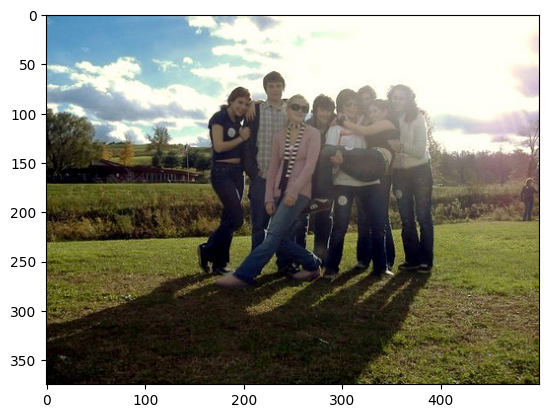

True:
 Young people pose for their picture in the countryside.
Generated:
 Girl people stack aerial are green hair beam.


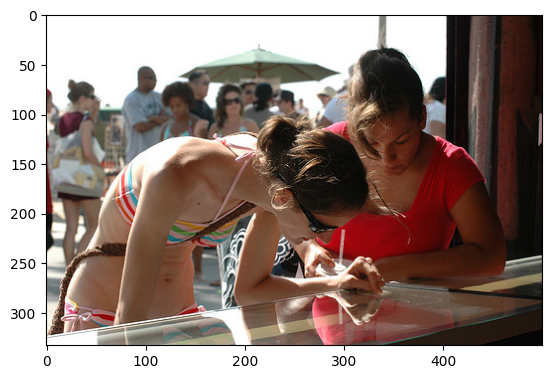

True:
 Two women are looking into a glass case.
Generated:
 Agi and a sliding of a toy.


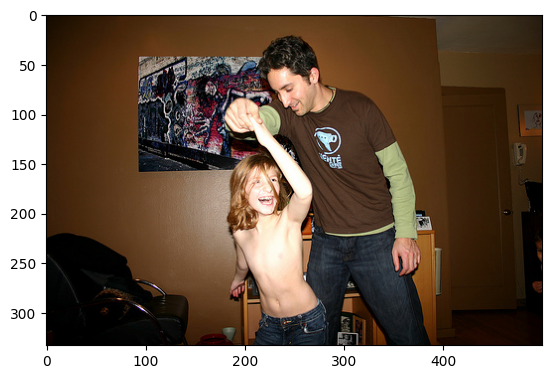

True:
 A shirtless child dances with an adult man.
Generated:
 A woman with another ski close is standing at a sidewalk aroundc - shirt a skate w.


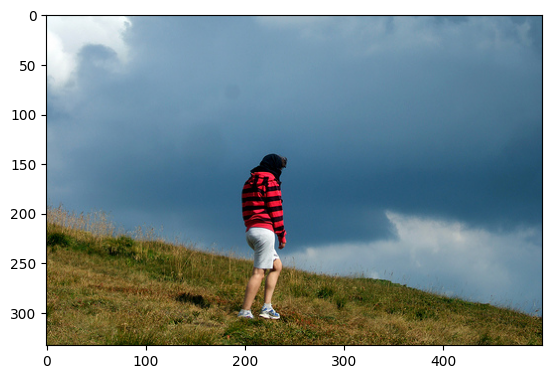

True:
 A woman in a striped sweater is standing on a hill.
Generated:
 A person in a pink slides near Despite.


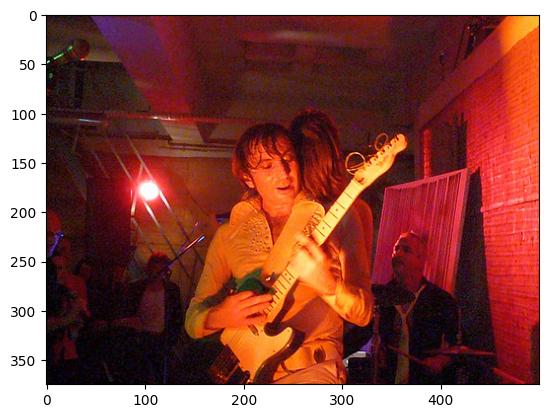

True:
 A man playing a guitar under the lights with other people in the background.
Generated:
 A man families Minneapolis racing on a black black ball in the oceans.


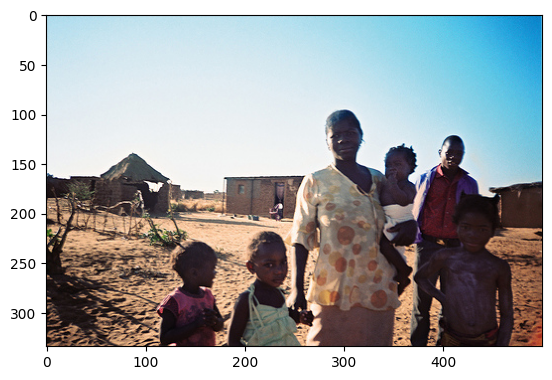

True:
 Family standing in a small village.
Generated:
 Peoples waving with a skier at a boysh.
--------------



Evaluation Progress: 100%|██████████| 48/48 [01:24<00:00,  1.75s/it]


Epoch 02 - Train loss = 3.7372	Val loss = 3.5195	Test loss = 3.5395
The best model is found and saved. Current best val loss = 3.520



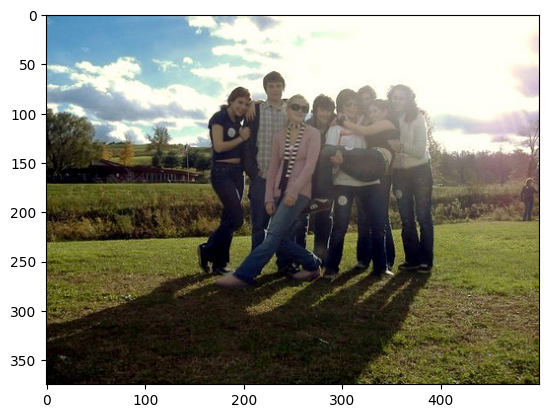

True:
 Young people pose for their picture in the countryside.
Generated:
 Two people Man in children.


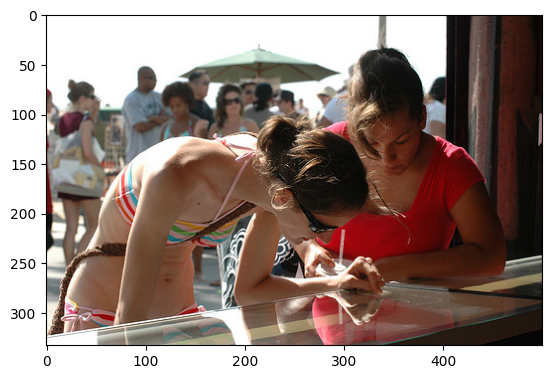

True:
 Two women are looking into a glass case.
Generated:
 A young girl is smiling tennis dress downhillpoli mined around her dog on the sand.


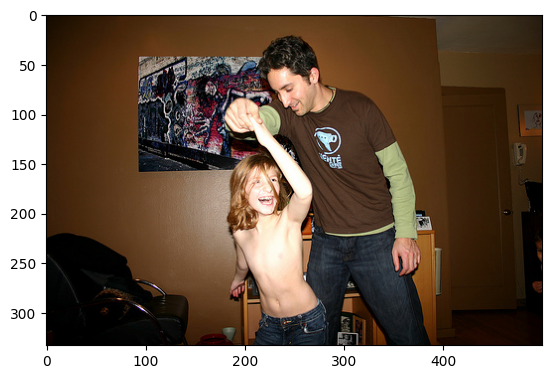

True:
 A shirtless child dances with an adult man.
Generated:
 Two boys watching gray GO pushing down a fair faded.


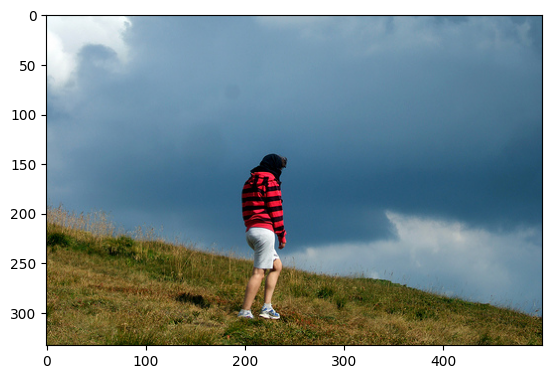

True:
 A woman in a striped sweater is standing on a hill.
Generated:
 A man sits on a tray on the yard


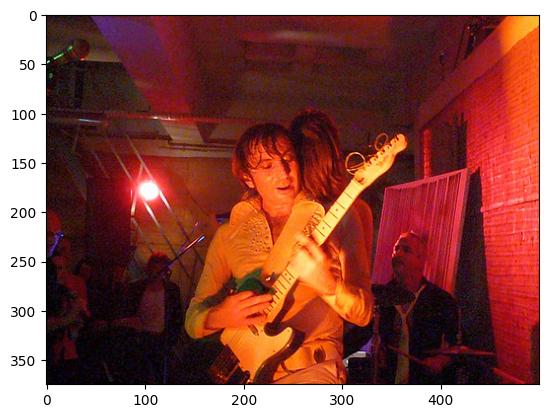

True:
 A man playing a guitar under the lights with other people in the background.
Generated:
 A girl is sitting on his mouth.


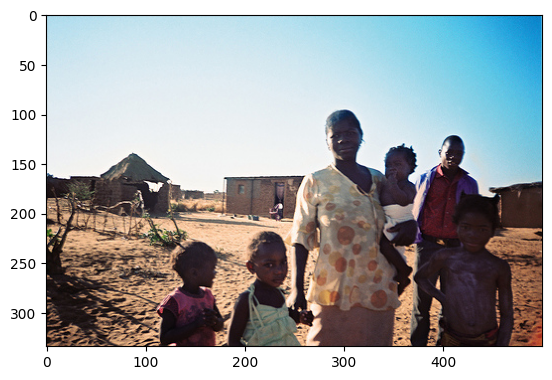

True:
 Family standing in a small village.
Generated:
 There are guitarllers are running in the grass.
--------------



Evaluation Progress: 100%|██████████| 48/48 [01:24<00:00,  1.76s/it]


Epoch 03 - Train loss = 3.3534	Val loss = 3.2711	Test loss = 3.2898
The best model is found and saved. Current best val loss = 3.271



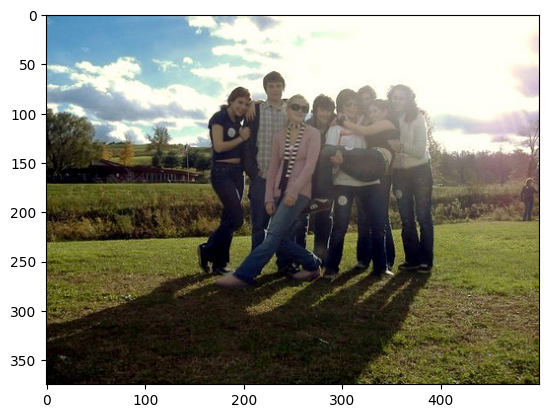

True:
 Young people pose for their picture in the countryside.
Generated:
 Two man pose members and a young boys outside.


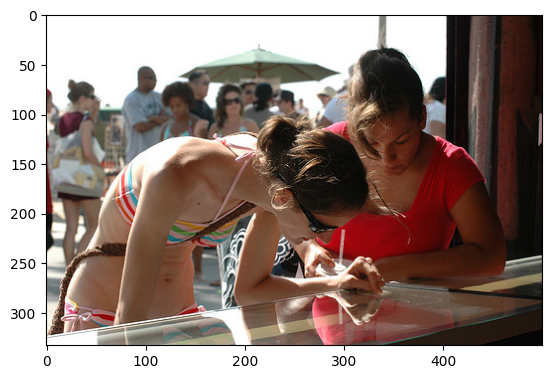

True:
 Two women are looking into a glass case.
Generated:
 Two girls are teen at a asleep suits a little girl in the water.


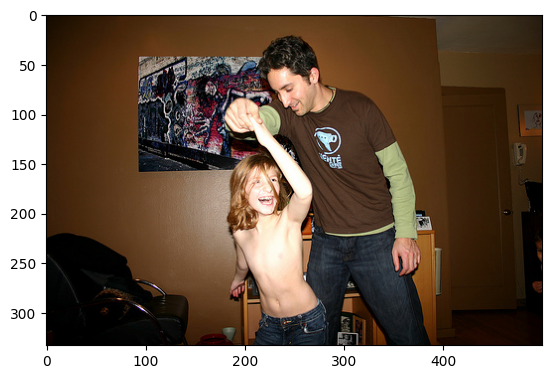

True:
 A shirtless child dances with an adult man.
Generated:
 A little boy catches a man standing next to a benchdie.


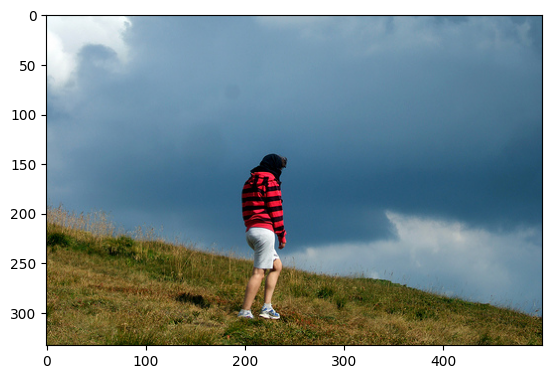

True:
 A woman in a striped sweater is standing on a hill.
Generated:
 Three and looking through the fans on the candy.


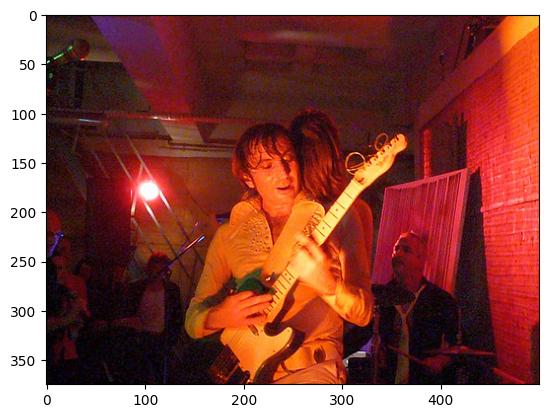

True:
 A man playing a guitar under the lights with other people in the background.
Generated:
 A man playing his women playing silhouette is a city.


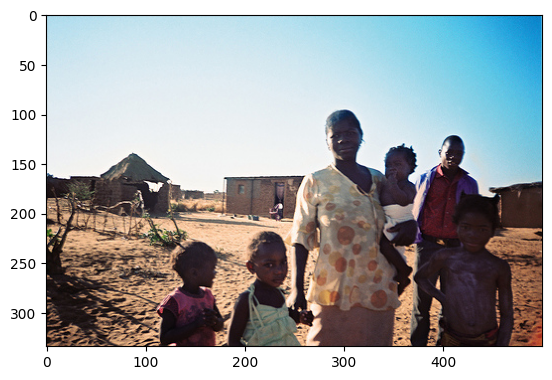

True:
 Family standing in a small village.
Generated:
 Two children jump standing amongbar in others range on the street
--------------



Evaluation Progress: 100%|██████████| 48/48 [01:24<00:00,  1.76s/it]


Epoch 04 - Train loss = 3.1033	Val loss = 3.0987	Test loss = 3.1181
The best model is found and saved. Current best val loss = 3.099



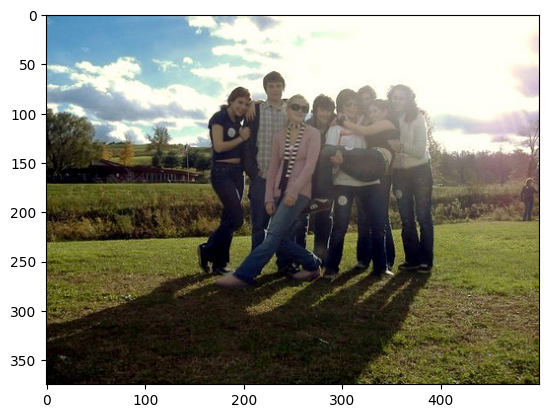

True:
 Young people pose for their picture in the countryside.
Generated:
 The man watches a pictured underneath a parade store.


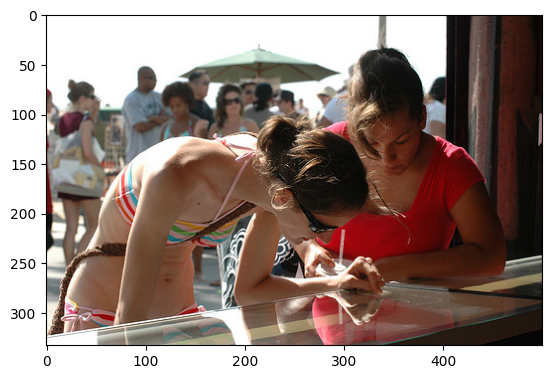

True:
 Two women are looking into a glass case.
Generated:
 a girl sitting in the camera.


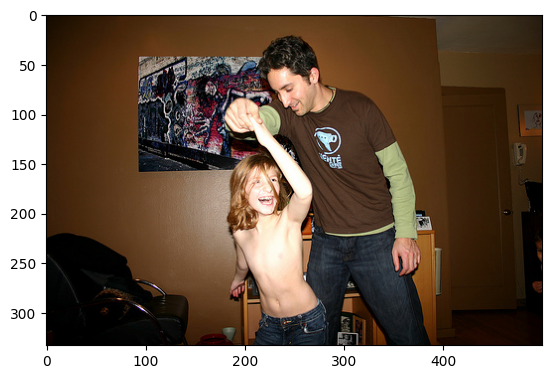

True:
 A shirtless child dances with an adult man.
Generated:
 Two children are two women and looking at an outdoor Netherlands.


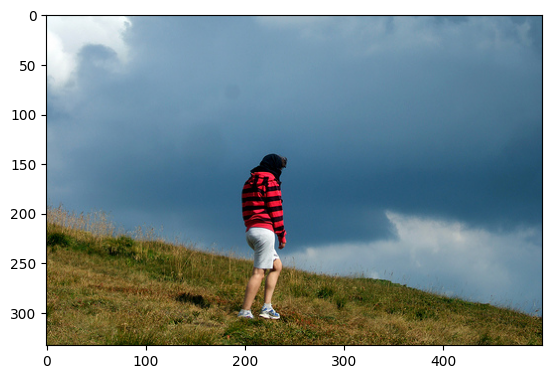

True:
 A woman in a striped sweater is standing on a hill.
Generated:
 A child football of horns about to a large building.


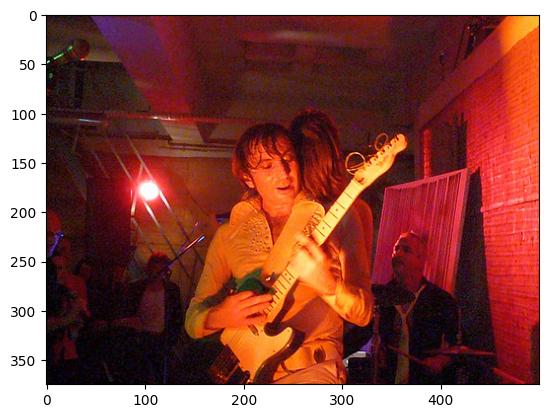

True:
 A man playing a guitar under the lights with other people in the background.
Generated:
 A man and a group of someone dancing posing for a


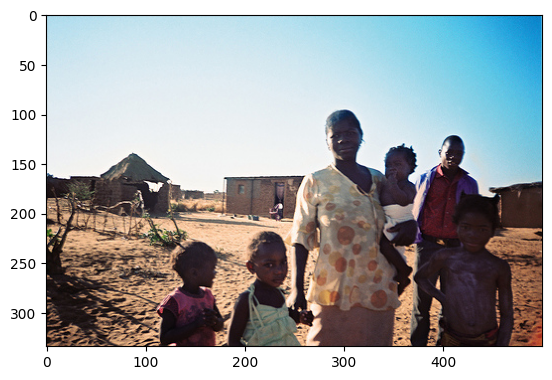

True:
 Family standing in a small village.
Generated:
 A young woman standing at a beach.
--------------



Evaluation Progress: 100%|██████████| 48/48 [01:24<00:00,  1.76s/it]


Epoch 05 - Train loss = 2.9161	Val loss = 2.9860	Test loss = 3.0055
The best model is found and saved. Current best val loss = 2.986



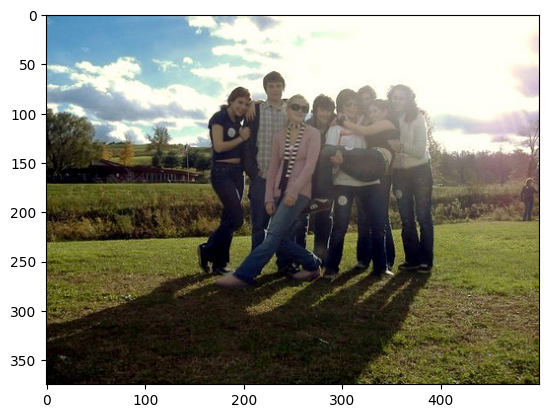

True:
 Young people pose for their picture in the countryside.
Generated:
 A group of people stand in front of a man looks on her back on.


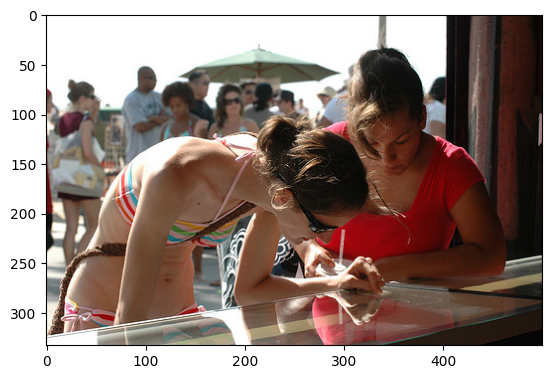

True:
 Two women are looking into a glass case.
Generated:
 A woman wears a red shirt splashes near a bride, playing in a banner at the ground.


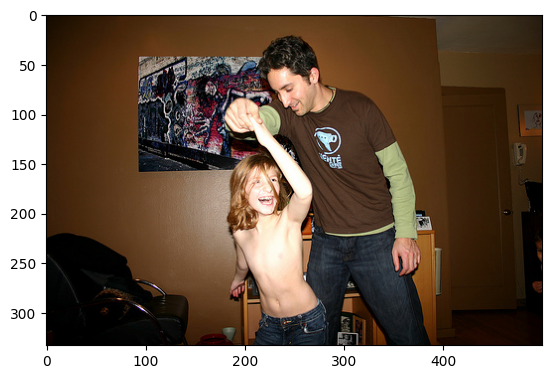

True:
 A shirtless child dances with an adult man.
Generated:
 The young woman's yard, costumes, placinging his toes up on his shoulder.


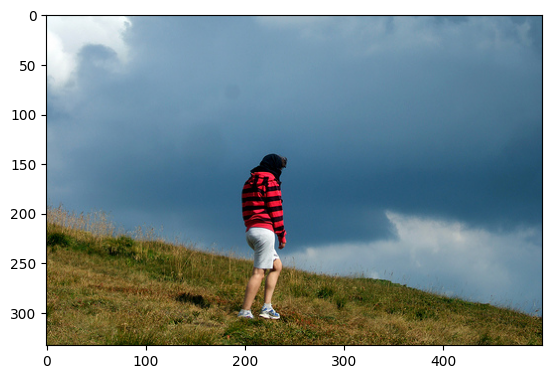

True:
 A woman in a striped sweater is standing on a hill.
Generated:
 A girl, one in sunglasses on the cliff.


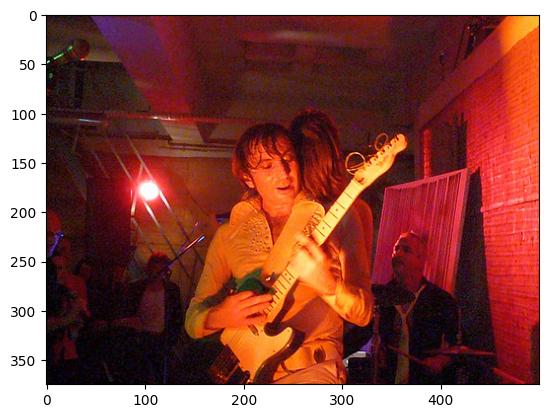

True:
 A man playing a guitar under the lights with other people in the background.
Generated:
 Two women are playing guitar and smoking each other.


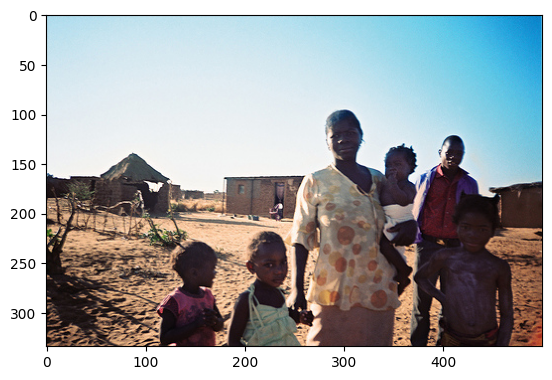

True:
 Family standing in a small village.
Generated:
 A girls are standing in the sand.
--------------



Evaluation Progress: 100%|██████████| 48/48 [01:24<00:00,  1.76s/it]


Epoch 06 - Train loss = 2.7658	Val loss = 2.9061	Test loss = 2.9230
The best model is found and saved. Current best val loss = 2.906



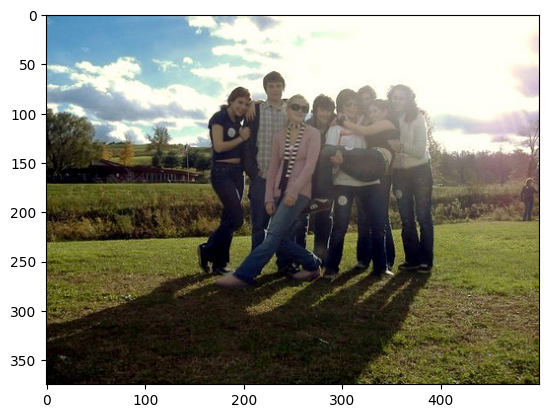

True:
 Young people pose for their picture in the countryside.
Generated:
 A group of people walking through a longpiece and an Asian truck.


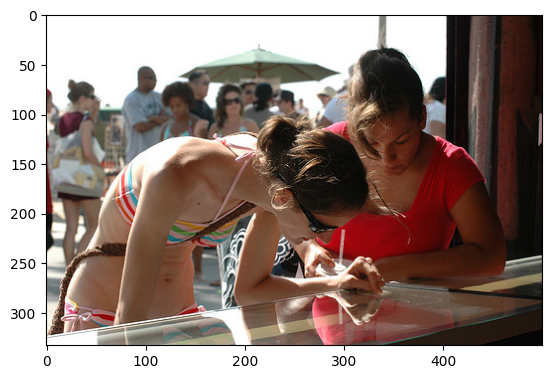

True:
 Two women are looking into a glass case.
Generated:
 A girls with a pink hair eating a husky girl


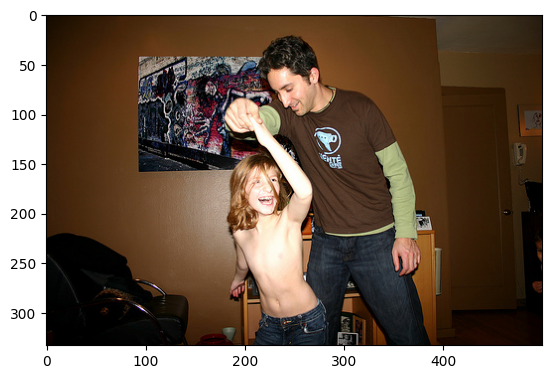

True:
 A shirtless child dances with an adult man.
Generated:
 A man works tops up a large posters slab an audience.


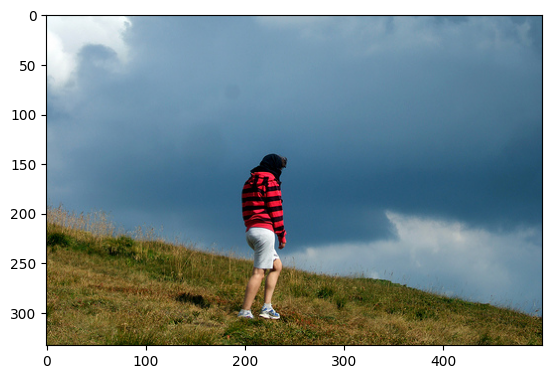

True:
 A woman in a striped sweater is standing on a hill.
Generated:
 A boy in the air while stands by a forest.


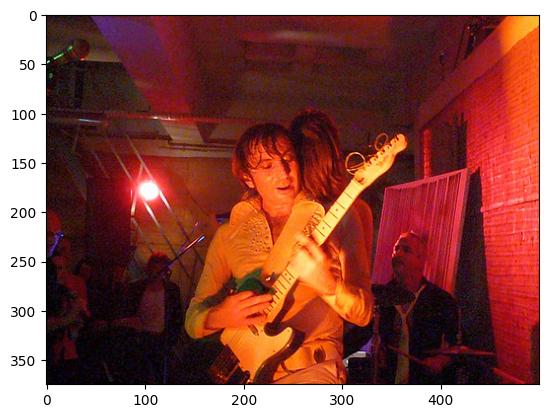

True:
 A man playing a guitar under the lights with other people in the background.
Generated:
 two men are w each other while their heads with lights waiting.


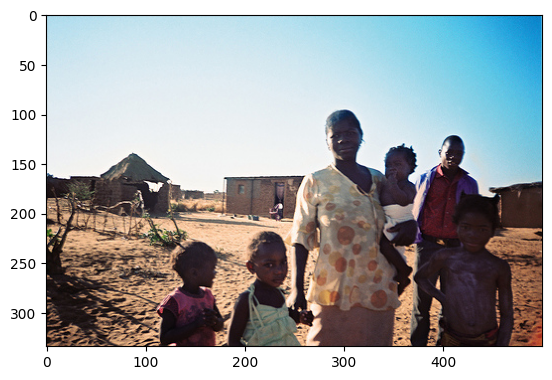

True:
 Family standing in a small village.
Generated:
 Children running outside of some on grass at some sand.
--------------



Evaluation Progress: 100%|██████████| 48/48 [01:23<00:00,  1.75s/it]


Epoch 07 - Train loss = 2.6418	Val loss = 2.8500	Test loss = 2.8654
The best model is found and saved. Current best val loss = 2.850



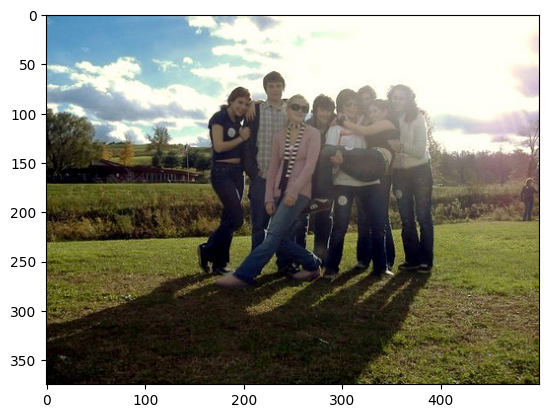

True:
 Young people pose for their picture in the countryside.
Generated:
 A group of young children climbing at Bay.


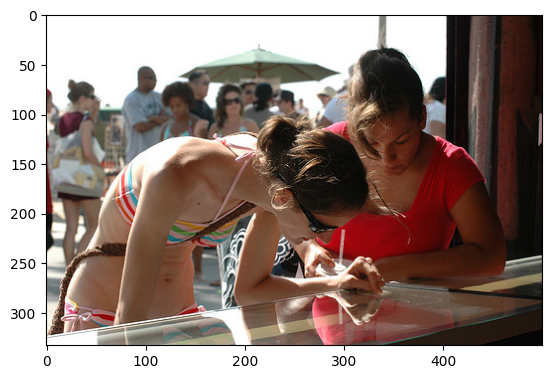

True:
 Two women are looking into a glass case.
Generated:
 A girls play in the swimming.


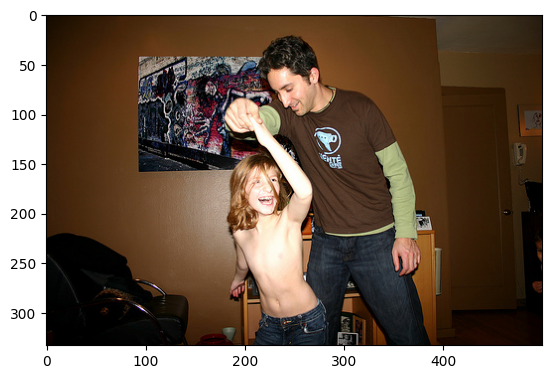

True:
 A shirtless child dances with an adult man.
Generated:
 A photographer is blowing a woman sits outside.


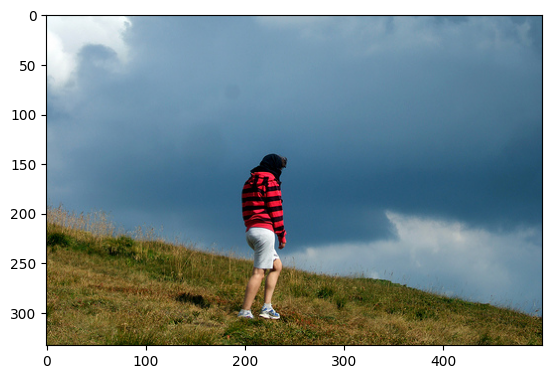

True:
 A woman in a striped sweater is standing on a hill.
Generated:
 A person sitting on a field.


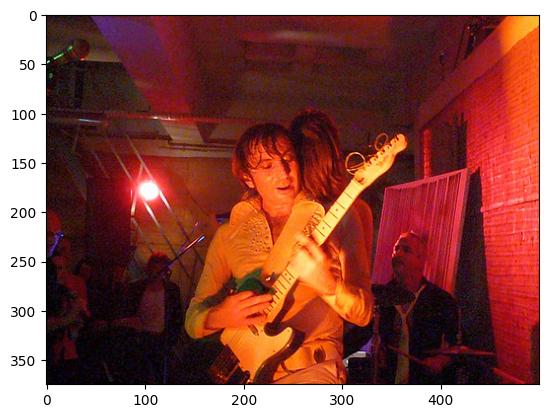

True:
 A man playing a guitar under the lights with other people in the background.
Generated:
 Two Dark colorful guitar.


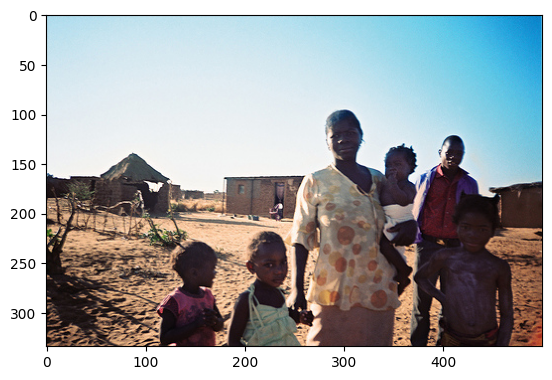

True:
 Family standing in a small village.
Generated:
 A little girl in pink top tries to the beach up a child on a sand dune.
--------------



Evaluation Progress: 100%|██████████| 48/48 [01:23<00:00,  1.75s/it]


Epoch 08 - Train loss = 2.5334	Val loss = 2.8050	Test loss = 2.8201
The best model is found and saved. Current best val loss = 2.805



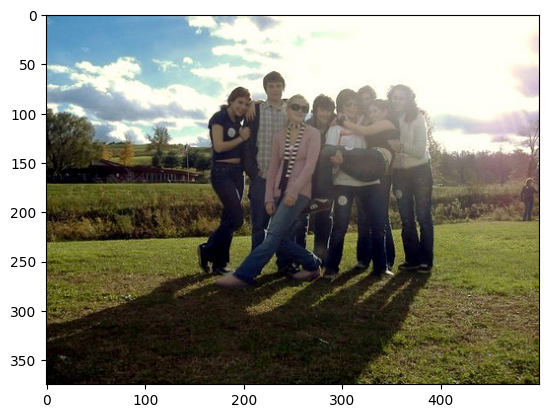

True:
 Young people pose for their picture in the countryside.
Generated:
 The hiker with her hair and mountains in the middle of a statue of a crowd of peopleo in black p structure.


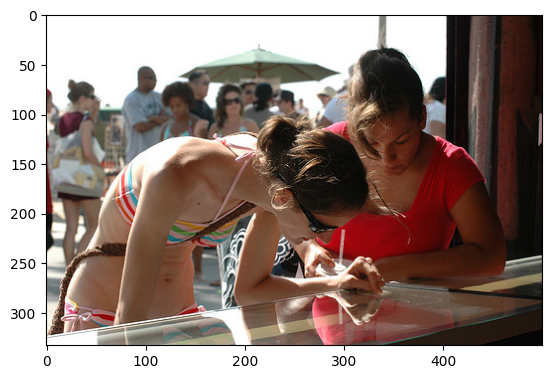

True:
 Two women are looking into a glass case.
Generated:
 A girl sits on the midst of eat children at a table at the beach


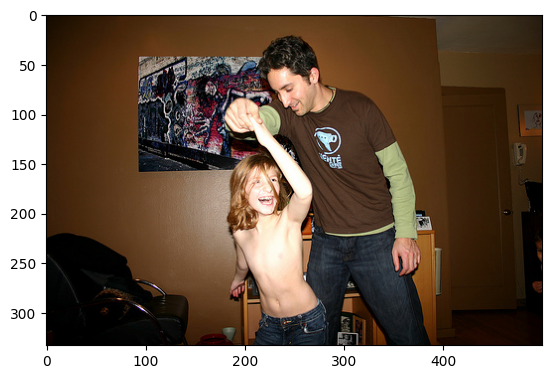

True:
 A shirtless child dances with an adult man.
Generated:
 Two young girls talk with their heads in mouth wide open.


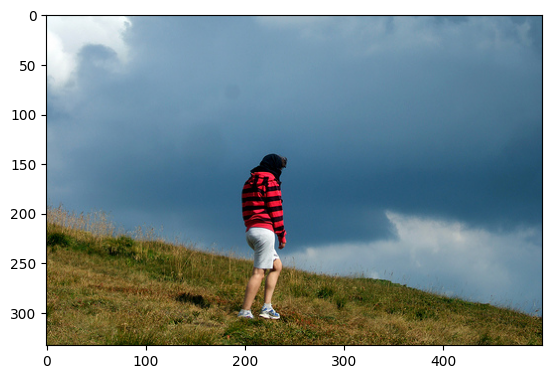

True:
 A woman in a striped sweater is standing on a hill.
Generated:
 A woman wearing a red shirt lying on a grassy hill.


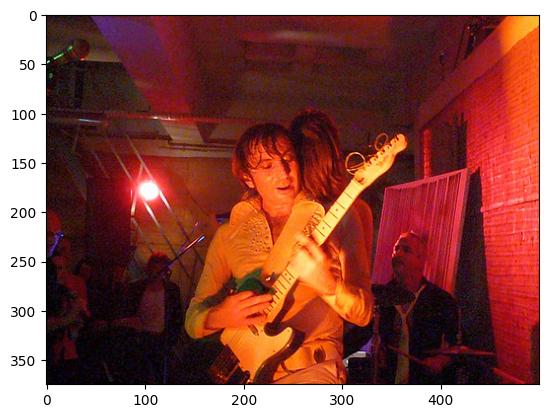

True:
 A man playing a guitar under the lights with other people in the background.
Generated:
 A woman dances while being at the bottom of a seatedry others look at the floor.


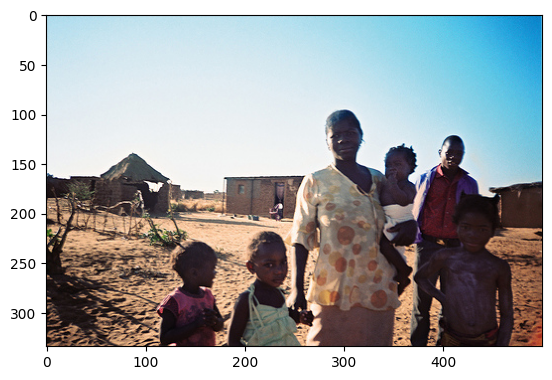

True:
 Family standing in a small village.
Generated:
 Girl in jeans walks along a trees as the other children who is staring at the camera.
--------------



Evaluation Progress: 100%|██████████| 48/48 [01:23<00:00,  1.74s/it]


Epoch 09 - Train loss = 2.4364	Val loss = 2.7629	Test loss = 2.7779
The best model is found and saved. Current best val loss = 2.763



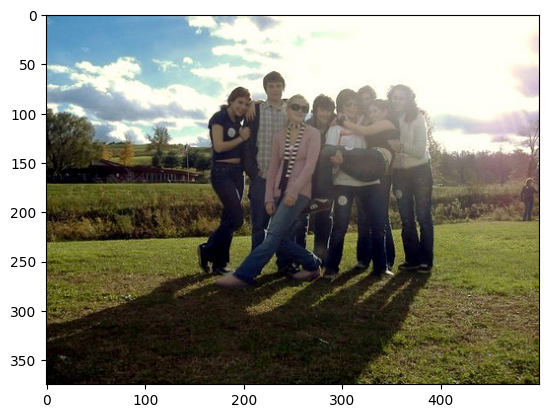

True:
 Young people pose for their picture in the countryside.
Generated:
 The girl wearing a black haty trees standing next to anes in a well cord of people.


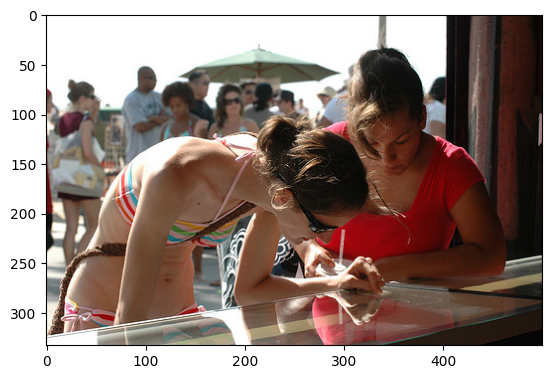

True:
 Two women are looking into a glass case.
Generated:
 Two Asian girls structure in the fancy of a crowded structure.


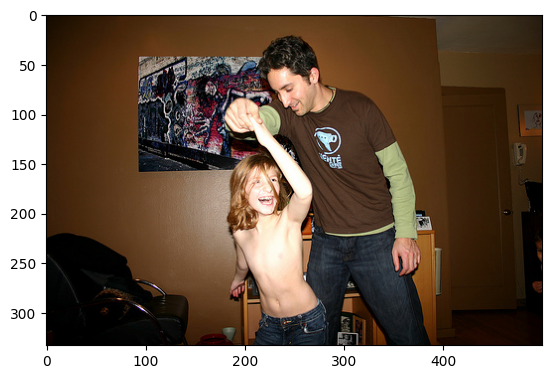

True:
 A shirtless child dances with an adult man.
Generated:
 Man climbingrs through a city - filled with sacks with three other women playful sticking a balloons up.


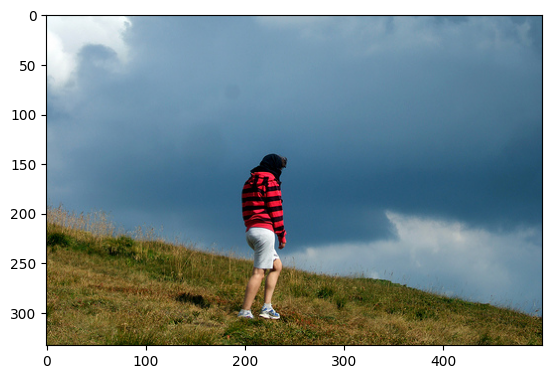

True:
 A woman in a striped sweater is standing on a hill.
Generated:
 A girl in a red coat.


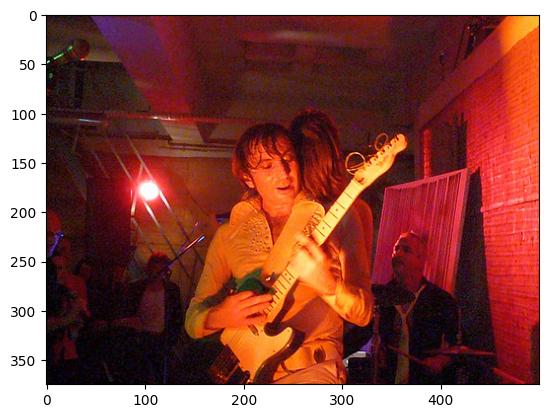

True:
 A man playing a guitar under the lights with other people in the background.
Generated:
 Two female at a starting wooden guitar and play at the beach.


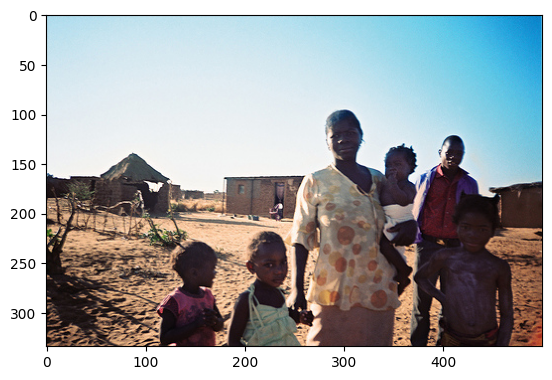

True:
 Family standing in a small village.
Generated:
 A small children playing in the green grass
--------------



Evaluation Progress: 100%|██████████| 48/48 [01:24<00:00,  1.76s/it]


Epoch 10 - Train loss = 2.3513	Val loss = 2.7387	Test loss = 2.7539
The best model is found and saved. Current best val loss = 2.739



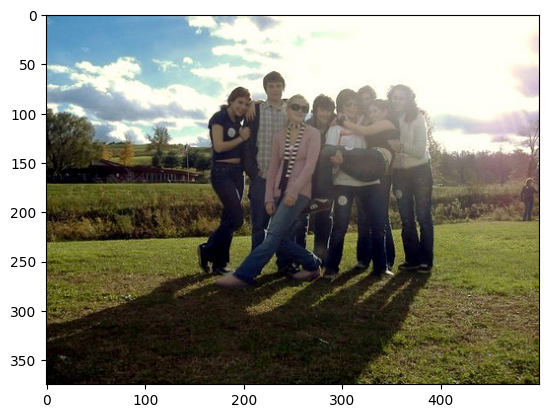

True:
 Young people pose for their picture in the countryside.
Generated:
 A man in a sweater holds a window.


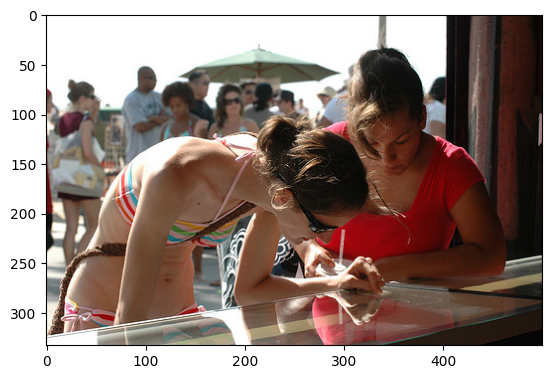

True:
 Two women are looking into a glass case.
Generated:
 a woman in a red shirt smiles at the girl.


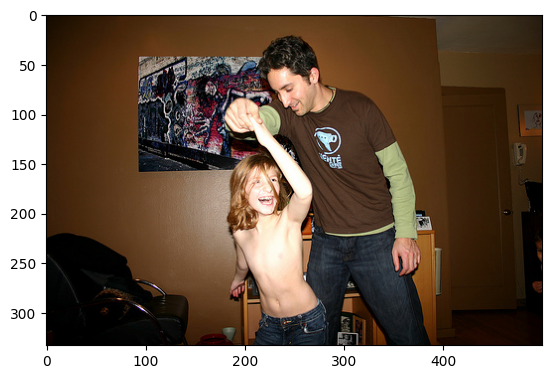

True:
 A shirtless child dances with an adult man.
Generated:
 A man in black leather jacket with paint and red hair pretend with long red hair looks on.


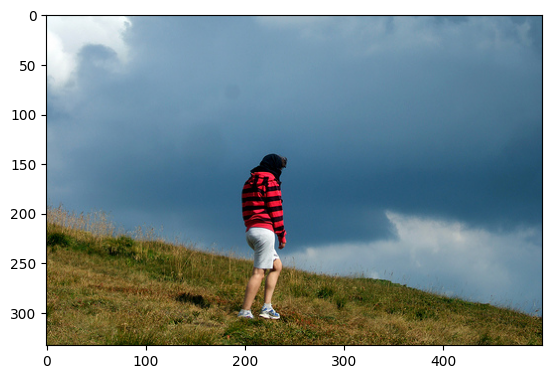

True:
 A woman in a striped sweater is standing on a hill.
Generated:
 A young woman is taking a huge backpack walks on a snow - covered hill.


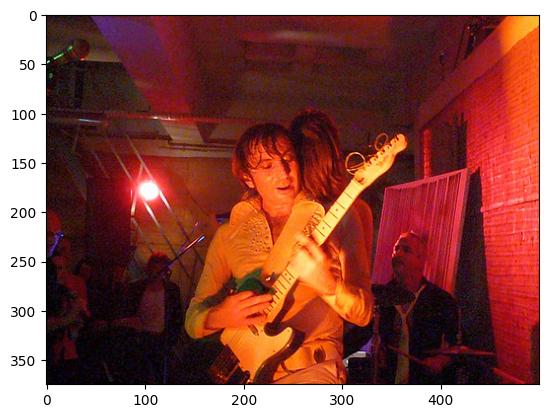

True:
 A man playing a guitar under the lights with other people in the background.
Generated:
 A woman in red and white uniform and two girls playing guitar, one on the other watch.


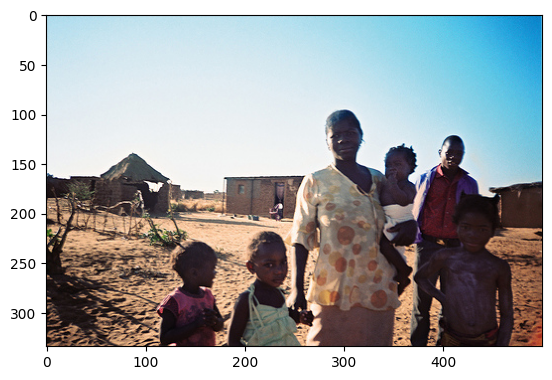

True:
 Family standing in a small village.
Generated:
 A group of people hiking up looking at the kid is in the older child.
--------------



In [52]:
# initialize model
model = CaptionGenerator(
    vocab_size=tokenizer.vocab_size,
    embed_size=EMBED_SIZE,
    max_seq_len=max_seq_len,
    nhead=NHEAD, 
    num_layers=NUM_LAYERS,
).to(DEVICE)

# initialize optimizer
optimizer = torch.optim.AdamW(model.parameters(), lr=LEARNING_RATE)

# initialize best val loss and best model streak count
best_val_loss = float('inf')
best_streak_count = 0

# iterate over epochs
for epoch_idx in range(1, N_EPOCHS+1):
    # train
    train_loss = train_epoch(model, feature_extractor, train_iterator, optimizer)    
    # evaluate 
    val_loss = evaluate(model, feature_extractor, val_iterator)
    test_loss = evaluate(model, feature_extractor, test_iterator)
    
    # print losses
    print(f"Epoch {epoch_idx:02} - Train loss = {train_loss:.4f}\tVal loss = {val_loss:.4f}\tTest loss = {test_loss:.4f}")
    
    # save the current model as the best model if the current val loss is the least achieved 
    if val_loss < best_val_loss:
        # save the curent model's parameters as the best model parameters
        torch.save(model.state_dict(), BEST_MODEL_FILEPATH)
        # replace the best test loss with the current best loss
        best_val_loss = val_loss
        # reset early stoppping counter 
        best_streak_count = 0
        # display info
        print(f'The best model is found and saved. Current best val loss = {best_val_loss:.3f}\n')
        
        # ------------------------------------------------------
        ct = 0
        for x, y0, y1 in inference_iterator:
            x = x.to(DEVICE)
            # generate caption
            generated_token_ids = generate(model, feature_extractor, x, tokenizer, temp=1.0, max_length=max_seq_len, device=DEVICE)
            caption_generated = tokenizer.decode(generated_token_ids)
            # get groundtruth caption
            caption_gt = tokenizer.decode(y0[0,1:-1].cpu().numpy().tolist())
            # show image
            img = Image.open(os.path.join(IMAGES_DIR, test_images[ct])).convert("RGB")
            plt.imshow(img)
            plt.show()
            # print generated and groundtruth captions
            print("True:\n", caption_gt)
            print("Generated:\n", caption_generated)
            ct += 1
            if ct > 5: break
        # ------------------------------------------------------
    else:
        # update early stoppping counter 
        best_streak_count += 1

    # check early stopping condition
    if best_streak_count == EARLY_STOPPING_STEP_SIZE:
        print(f"A better model has not been found in the last {EARLY_STOPPING_STEP_SIZE} epochs. Early stopping...")
        break
        
    print("--------------\n")